<a href="https://colab.research.google.com/github/AryanKaushal2002/Species-Classification-Model/blob/main/Species_Calssification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Extracting dataset

In [ ]:
!pip install kaggle

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# configuring the path of Kaggle.json file
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

Importing the Dog vs Cat Dataset from Kaggle

In [ ]:
#Kaggle api
!kaggle competitions download -c dogs-vs-cats

100% 811M/812M [00:21<00:00, 42.1MB/s]
100% 812M/812M [00:21<00:00, 39.8MB/s]


In [ ]:
# extracting the compressed dataset
from zipfile import ZipFile

dataset = '/content/dogs-vs-cats.zip'

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [ ]:
# extracting the compressed dataset
from zipfile import ZipFile

dataset = '/content/train.zip'

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [ ]:
import os
# counting the number of files in train folder
path, dirs, files = next(os.walk('/content/train'))
file_count = len(files)
print('Number of images: ', file_count)

Number of images:  25000


Printing the name of images

In [ ]:
file_names = os.listdir('/content/train/')
print(file_names)

['dog.9890.jpg', 'cat.12164.jpg', 'dog.1148.jpg', 'dog.631.jpg', 'dog.521.jpg', 'cat.6056.jpg', 'cat.4778.jpg', 'dog.7353.jpg', 'dog.12044.jpg', 'cat.1649.jpg', 'cat.12026.jpg', 'cat.11705.jpg', 'dog.1235.jpg', 'dog.7931.jpg', 'cat.4980.jpg', 'dog.348.jpg', 'cat.4846.jpg', 'cat.5522.jpg', 'dog.6748.jpg', 'dog.5854.jpg', 'dog.5317.jpg', 'dog.757.jpg', 'dog.2496.jpg', 'dog.12154.jpg', 'cat.4279.jpg', 'cat.2253.jpg', 'cat.4070.jpg', 'dog.9629.jpg', 'dog.10618.jpg', 'cat.3524.jpg', 'dog.5657.jpg', 'dog.559.jpg', 'dog.1248.jpg', 'cat.6530.jpg', 'dog.10649.jpg', 'cat.9529.jpg', 'cat.6226.jpg', 'dog.10650.jpg', 'cat.702.jpg', 'dog.3110.jpg', 'cat.2257.jpg', 'dog.4863.jpg', 'dog.964.jpg', 'cat.10445.jpg', 'cat.6463.jpg', 'dog.5994.jpg', 'cat.4409.jpg', 'cat.7246.jpg', 'cat.6806.jpg', 'dog.11944.jpg', 'dog.6147.jpg', 'cat.4563.jpg', 'dog.6431.jpg', 'dog.3634.jpg', 'dog.1332.jpg', 'cat.2476.jpg', 'cat.4647.jpg', 'dog.5687.jpg', 'cat.5798.jpg', 'cat.10075.jpg', 'dog.11350.jpg', 'dog.10229.jpg', '

Importing the Dependencies

In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.model_selection import train_test_split
from google.colab.patches import cv2_imshow

Displaying the images of dogs and cats

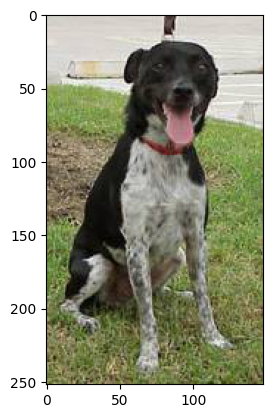

In [ ]:
# display dog image
img = mpimg.imread('/content/train/dog.9890.jpg')
imgplt = plt.imshow(img)
plt.show()

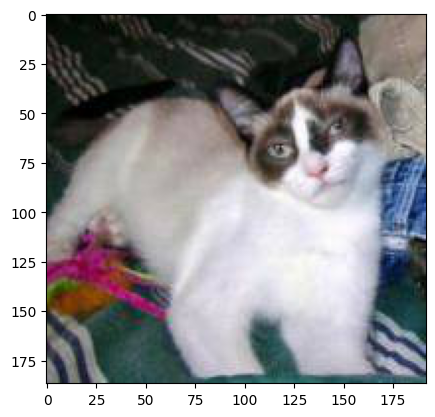

In [ ]:
# display cat image
img = mpimg.imread('/content/train/cat.6056.jpg')
imgplt = plt.imshow(img)
plt.show()

In [ ]:
file_names = os.listdir('/content/train/')

dog_count = 0
cat_count = 0

for img_file in file_names:

  name = img_file[0:3]

  if name == 'dog':
    dog_count += 1

  else:
    cat_count += 1

print('Number of dog images =', dog_count)
print('Number of cat images =', cat_count)

Number of dog images = 12500
Number of cat images = 12500


Resizing all the images

In [ ]:
#creating a directory for resized images
os.mkdir('/content/image resized')

In [ ]:
original_folder = '/content/train/'
resized_folder = '/content/image resized/'

for i in range(2000):

  filename = os.listdir(original_folder)[i]
  img_path = original_folder+filename

  img = Image.open(img_path)
  img = img.resize((224, 224))
  img = img.convert('RGB')

  newImgPath = resized_folder+filename
  img.save(newImgPath)

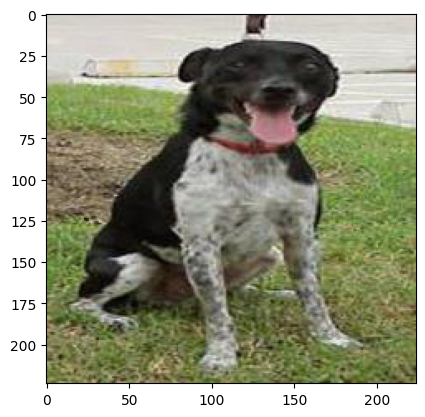

In [ ]:
# display resized dog image
img = mpimg.imread('/content/image resized/dog.9890.jpg')
imgplt = plt.imshow(img)
plt.show()

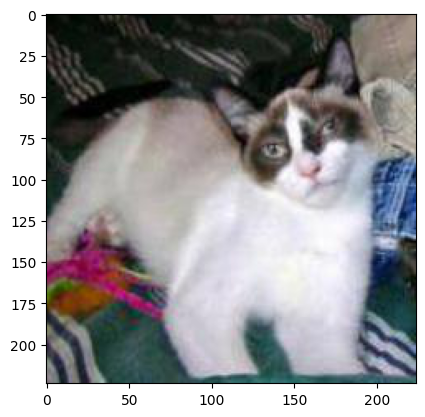

In [ ]:
# display resized cat image
img = mpimg.imread('/content/image resized/cat.6056.jpg')
imgplt = plt.imshow(img)
plt.show()

In [ ]:
file_names = os.listdir('/content/image resized/')
print(file_names)

['dog.9890.jpg', 'cat.12164.jpg', 'dog.1148.jpg', 'dog.631.jpg', 'dog.521.jpg', 'cat.6056.jpg', 'cat.4778.jpg', 'dog.7353.jpg', 'dog.12044.jpg', 'cat.1649.jpg', 'cat.12026.jpg', 'cat.11705.jpg', 'dog.1235.jpg', 'dog.7931.jpg', 'cat.4980.jpg', 'dog.348.jpg', 'cat.4846.jpg', 'cat.5522.jpg', 'dog.6748.jpg', 'dog.5854.jpg', 'dog.5317.jpg', 'dog.757.jpg', 'dog.2496.jpg', 'dog.12154.jpg', 'cat.4279.jpg', 'cat.2253.jpg', 'cat.4070.jpg', 'dog.9629.jpg', 'dog.10618.jpg', 'cat.3524.jpg', 'dog.5657.jpg', 'dog.559.jpg', 'dog.1248.jpg', 'cat.6530.jpg', 'dog.10649.jpg', 'cat.9529.jpg', 'cat.6226.jpg', 'dog.10650.jpg', 'cat.702.jpg', 'dog.3110.jpg', 'cat.2257.jpg', 'dog.4863.jpg', 'dog.964.jpg', 'cat.10445.jpg', 'cat.6463.jpg', 'dog.5994.jpg', 'cat.4409.jpg', 'cat.7246.jpg', 'cat.6806.jpg', 'dog.11944.jpg', 'dog.6147.jpg', 'cat.4563.jpg', 'dog.6431.jpg', 'dog.3634.jpg', 'dog.1332.jpg', 'cat.2476.jpg', 'cat.4647.jpg', 'dog.5687.jpg', 'cat.5798.jpg', 'cat.10075.jpg', 'dog.11350.jpg', 'dog.10229.jpg', '



Creating labels for resized images of dogs and cats

Cat --> 0

Dog --> 1


In [ ]:
filenames = os.listdir('/content/image resized/')

labels=[]
for i in range(2000):
  file_name=filenames[i]
  label=file_name[0:3]

  if label=='dog':
    labels.append(1)
  else:
    labels.append(0)

In [ ]:
print(filenames[0:5])
print(len(filenames))

print(labels[0:5])
print(len(labels))

['dog.9890.jpg', 'cat.12164.jpg', 'dog.1148.jpg', 'dog.631.jpg', 'dog.521.jpg']
2000
[1, 0, 1, 1, 1]
2000


In [ ]:
# counting the images of dogs and cats out of 2000 images
values, counts = np.unique(labels, return_counts=True)
print(values)
print(counts)

[0 1]
[ 975 1025]


Converting all the resized images to numpy arrays

In [ ]:
import cv2
import glob

In [ ]:
image_directory = '/content/image resized/'
image_extension = ['png','jpg']

files=[]

[files.extend(glob.glob(image_directory+'*.'+e)) for e in image_extension]

dog_cat_images = np.asarray([cv2.imread(file) for file in files])

In [ ]:
type(dog_cat_images)

numpy.ndarray

In [ ]:
print(dog_cat_images.shape)

(2000, 224, 224, 3)


Spliting the data

In [ ]:
X = dog_cat_images
y = np.asarray(labels)

Train Test Split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=2)

In [ ]:
print(X.shape, X_train.shape, X_test.shape)

(2000, 224, 224, 3) (1600, 224, 224, 3) (400, 224, 224, 3)


So we have,


1600 --> training images

400 --> test images


In [ ]:
# scaling the data
X_train_scaled = X_train/255

X_test_scaled = X_test/255

In [ ]:
print(X_train_scaled)

[[[[0.0627451  0.07843137 0.17254902]
   [0.09019608 0.10588235 0.2       ]
   [0.08627451 0.10980392 0.2       ]
   ...
   [0.03529412 0.04705882 0.06666667]
   [0.02352941 0.03529412 0.05490196]
   [0.03137255 0.04313725 0.0627451 ]]

  [[0.0745098  0.09019608 0.18823529]
   [0.09411765 0.10980392 0.20392157]
   [0.09019608 0.10980392 0.20784314]
   ...
   [0.03529412 0.04705882 0.06666667]
   [0.02745098 0.03529412 0.06666667]
   [0.03529412 0.04705882 0.06666667]]

  [[0.08235294 0.09803922 0.20784314]
   [0.09803922 0.11764706 0.21568627]
   [0.09019608 0.10588235 0.21568627]
   ...
   [0.04313725 0.05098039 0.08235294]
   [0.03529412 0.03921569 0.07843137]
   [0.03921569 0.04705882 0.07843137]]

  ...

  [[0.08627451 0.0627451  0.06666667]
   [0.09019608 0.06666667 0.07058824]
   [0.09803922 0.0745098  0.07843137]
   ...
   [0.01960784 0.02352941 0.00784314]
   [0.04705882 0.05098039 0.03529412]
   [0.01960784 0.02352941 0.00784314]]

  [[0.08627451 0.0627451  0.06666667]
   [0.0

Building the Neural Network

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub

In [ ]:
mobilenet_model = 'https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4'

pretrained_model = hub.KerasLayer(mobilenet_model, input_shape=(224,224,3), trainable=False)

In [ ]:
num_of_classes = 2

model = tf.keras.Sequential([
    pretrained_model,
    tf.keras.layers.Dense(num_of_classes)
])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1280)              2257984   
                                                                 
 dense (Dense)               (None, 2)                 2562      
                                                                 
Total params: 2,260,546
Trainable params: 2,562
Non-trainable params: 2,257,984
_________________________________________________________________


In [ ]:
model.compile(
    optimizer = 'adam',
    loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics=['acc']
)


In [ ]:
model.fit(X_train_scaled,y_train,epochs=5)

Epoch 1/5
50/50 [==============================] - 71s 1s/step - loss: 0.1895 - acc: 0.9237
Epoch 2/5
50/50 [==============================] - 66s 1s/step - loss: 0.0725 - acc: 0.9719
Epoch 3/5
50/50 [==============================] - 65s 1s/step - loss: 0.0553 - acc: 0.9800
Epoch 4/5
50/50 [==============================] - 83s 2s/step - loss: 0.0435 - acc: 0.9831
Epoch 5/5
50/50 [==============================] - 67s 1s/step - loss: 0.0379 - acc: 0.9887


In [ ]:
score,acc = model.evaluate(X_test_scaled,y_test)
print('Test Loss = ',score)
print('Test Accuracy = ',acc)

13/13 [==============================] - 18s 1s/step - loss: 0.0673 - acc: 0.9725
Test Loss =  0.06727667897939682
Test Accuracy =  0.9725000262260437


Predictive System

Path of the image to be predicted: /content/dog.jpg


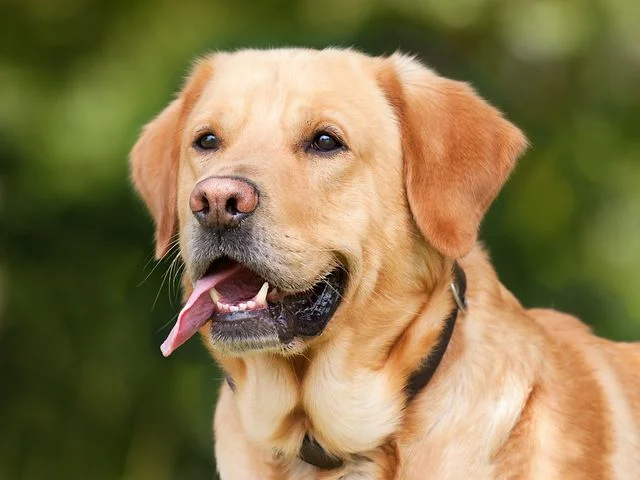

1/1 [==============================] - 1s 565ms/step
[[-4.3842177  5.3410845]]
1
The image represents a Dog


In [ ]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resize = cv2.resize(input_image, (224,224))

input_image_scaled = input_image_resize/255

image_reshaped = np.reshape(input_image_scaled, [1,224,224,3])

input_prediction = model.predict(image_reshaped)

print(input_prediction)

input_pred_label = np.argmax(input_prediction)

print(input_pred_label)

if input_pred_label == 0:
  print('The image represents a Cat')

else:
  print('The image represents a Dog')

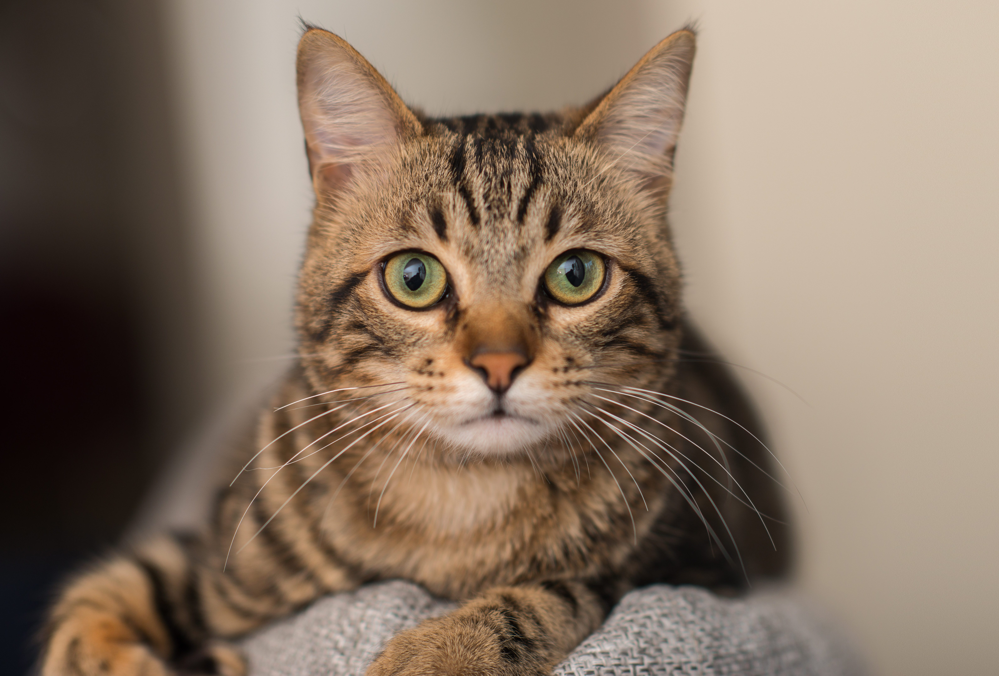

1/1 [==============================] - 0s 137ms/step
[[ 3.9385471 -3.4532409]]
0
The image represents a Cat


In [61]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resize = cv2.resize(input_image, (224,224))

input_image_scaled = input_image_resize/255

image_reshaped = np.reshape(input_image_scaled, [1,224,224,3])

input_prediction = model.predict(image_reshaped)

print(input_prediction)

input_pred_label = np.argmax(input_prediction)

print(input_pred_label)

if input_pred_label == 0:
  print('The image represents a Cat')

else:
  print('The image represents a Dog')